# inspect miniCT data

In [1]:
from glob import glob
import xarray as xr
import pandas as pd
import os
import numpy as np

import pynsitu as pin

C:\Tools\Miniconda3\envs\pynsitu\lib\site-packages\pyTMD\spatial.py:82: ImportWarning: GDAL not available
  warnings.warn("GDAL not available", ImportWarning)
<frozen importlib._bootstrap>:241: RuntimeWarning: numpy.ndarray size changed, may indicate binary incompatibility. Expected 16 from C header, got 96 from PyObject


In [2]:
root_dir=r"E:\CSWOT"
#file_lists = sorted(glob(os.path.join(root_dir,r"MiniCT\Hourly\*.txt")))[21:]

In [3]:
# modifie par valerie
def _get_tstamp_dir(d):
    """get time stamp of directory"""
    day = d.split("/")[-1].split("_")[0]
    day = pd.Timestamp(year=int(day[:4]), month=int(day[4:6]), day=int(day[6:8]))
    return day


def _parser(l):
    if len(l) > 0:
        # valerie
        if len(l.split("."))==2:
            return float(l)
        else:
            return ll2dec(l.split(";")[0], l.split(";")[1][:-1], l[-1])
    else:
        return np.NaN


def _emptystring2nan(s):
    if isinstance(s, str) and len(s) == 0:
        return np.NaN
    else:
        return s


def ll2dec(deg, minute, direction):
    if direction == "N" or direction == "E":
        sign = 1
    else:
        sign = -1
    return sign * (float(deg) + float(minute) / 60)


def read_drix_file(file, lon_key, lat_key):
    """load DriX txt data (logged with qinsy)"""

    with open(file, encoding="unicode_escape") as f:
        d = list(f.readlines())
        # replace return carriage from the end of the strings, split each string into a list
        d = [row.replace("\n", "").split(",") for row in d]

    # split in chunks if header changes
    D, C = [], []
    _d = []
    for row in d:
        if row[0] != "Date":
            # fill in data
            _d.append(row)
        else:
            # update column description
            C.append(row)
            if _d:
                D.append(_d)
                _d = []
    D.append(_d)

    DF = []
    for _d, _c in zip(D, C):
        df = pd.DataFrame(_d, columns=_c)
        # convert column 0 and 1 to a datetime
        df["time"] = pd.to_datetime(df["Date"] + " " + df["Time"])
        df.set_index("time", inplace=True)
        # parse coordinates
        df[lat_key + "_tmp"] = df[lat_key].map(_parser)
        df[lon_key + "_tmp"] = df[lon_key].map(_parser)
        # get rid of empty strings
        df = df.applymap(_emptystring2nan)
        # clean up
        df = df.drop(columns=["Date", "Time", lon_key, lat_key])
        df = df.rename(columns={lon_key + "_tmp": lon_key, lat_key + "_tmp": lat_key})
        DF.append(df)

    # convert all columns but index to float
    df = pd.concat(DF)
    for c in df:
        df[c] = df[c].astype(float)

    return df


def read_drix_data(root_dir, lon_key, lat_key):
    """Read a set of DriX files"""

    # _dirs = sorted(glob(os.path.join(root_dir, "*")))
    _dirs = sorted(glob(os.path.join(root_dir, "MiniCT")))

    dirs = pd.DataFrame(
        dict(dirs=_dirs),
        # index=[[_get_tstamp_dir(d) for d in _dirs]], # valerie pas de directory avec la date
    )

    files = []
    for d, s in dirs.iterrows():
# valerie        files = files + sorted(glob(os.path.join(s["dirs"], "Daily_Log/*.txt")))
        files = files + sorted(glob(os.path.join(s["dirs"], "Hourly/*.txt")))
        #files = files + sorted(glob(os.path.join(s["dirs"], "*.txt")))

    # dev
    # files = files[:2]

    # days = {d:d for d in dirs}
    # tstamps = [_get_tstamp(file) for file in files]
    # files = [f for f, t in zip(files, tstamps)
    #         if (t<=cp.end.ceil("d")) and (t>=cp.start.floor("d"))
    #        ]

    df = pd.concat([read_drix_file(f, lon_key, lat_key) for f in files])

    return df

In [4]:
#miniCT = read_drix_data(
#    os.path.join(root_dir, "MiniCT"), "MiniCT Longitude", "MiniCT Latitude"
#)

In [5]:
miniCT = read_drix_data(
    root_dir, "MiniCT Longitude", "MiniCT Latitude"
)

miniCT = miniCT.rename(
    columns={
        "MiniCT Height": "height",
        "MiniCT Latitude": "lat",
        "MiniCT Longitude": "lon",
        "Conductivité Value": "conductivity",
        "Temperature Value": "temp",
    }
)

miniCT.loc[:,"depth"] = 2.
miniCT.sw.update_eos()

some values of longitude and latitudes are NaN, you may want to fill in with correct values


In [6]:
# store to netcdf
ds = miniCT.to_xarray()
ds.to_netcdf("DriX_miniCT.nc")

In [7]:
# Make sure the saving is correct
filenc = "C:\\Utilisateurs\\globe\\cswot_python\\adcp\\cswot_adcp\sandbox\\DriX_miniCT.nc"
filenc = "C:\\Users\\globe\\cswot_python\\adcp\\cswot_adcp\sandbox\\DriX_miniCT.nc"
verif = xr.open_dataset(filenc)
xr.testing.assert_identical(ds,verif)

<Axes: xlabel='time'>

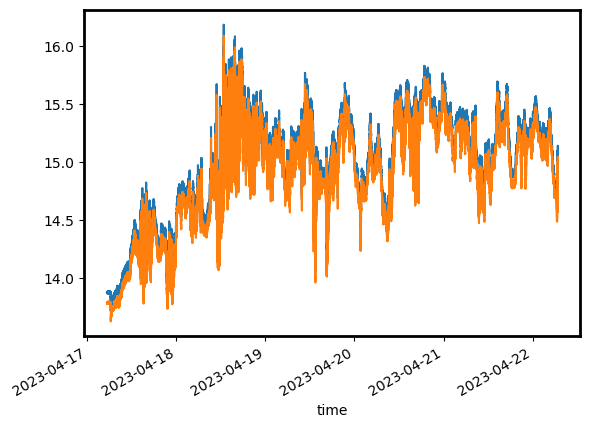

In [8]:
#df["Temperature Value"].astype(float).plot()
miniCT.temp.plot()
miniCT.CT.plot()

In [9]:
import hvplot.pandas

In [10]:
miniCT.hvplot(x="lon", y="lat", geo=True)

:Curve   [lon]   (lat)

In [ ]:
# reference
def _get_tstamp_dir(d):
    """get time stamp of directory"""
    day = d.split("/")[-1].split("_")[0]
    day = pd.Timestamp(year=int(day[:4]), month=int(day[4:6]), day=int(day[6:8]))
    return day


def _parser(l):
    if len(l) > 0:
        return ll2dec(l.split(";")[0], l.split(";")[1][:-1], l[-1])
    else:
        return np.NaN


def _emptystring2nan(s):
    if isinstance(s, str) and len(s) == 0:
        return np.NaN
    else:
        return s


def ll2dec(deg, minute, direction):
    if direction == "N" or direction == "E":
        sign = 1
    else:
        sign = -1
    return sign * (float(deg) + float(minute) / 60)


def read_drix_file(file, lon_key, lat_key):
    """load DriX txt data (logged with qinsy)"""

    with open(file, encoding="unicode_escape") as f:
        d = list(f.readlines())
        # replace return carriage from the end of the strings, split each string into a list
        d = [row.replace("\n", "").split(",") for row in d]

    # split in chunks if header changes
    D, C = [], []
    _d = []
    for row in d:
        if row[0] != "Date":
            # fill in data
            _d.append(row)
        else:
            # update column description
            C.append(row)
            if _d:
                D.append(_d)
                _d = []
    D.append(_d)

    DF = []
    for _d, _c in zip(D, C):
        df = pd.DataFrame(_d, columns=_c)
        # convert column 0 and 1 to a datetime
        df["time"] = pd.to_datetime(df["Date"] + " " + df["Time"])
        df.set_index("time", inplace=True)
        # parse coordinates
        df[lat_key + "_tmp"] = df[lat_key].map(_parser)
        df[lon_key + "_tmp"] = df[lon_key].map(_parser)
        # get rid of empty strings
        df = df.applymap(_emptystring2nan)
        # clean up
        df = df.drop(columns=["Date", "Time", lon_key, lat_key])
        df = df.rename(columns={lon_key + "_tmp": lon_key, lat_key + "_tmp": lat_key})
        DF.append(df)

    # convert all columns but index to float
    df = pd.concat(DF)
    for c in df:
        df[c] = df[c].astype(float)

    return df


def read_drix_data(root_dir, lon_key, lat_key):
    """Read a set of DriX files"""

    _dirs = sorted(glob(os.path.join(root_dir, "*")))
    dirs = pd.DataFrame(
        dict(dirs=_dirs),
        index=[[_get_tstamp_dir(d) for d in _dirs]],
    )

    files = []
    for d, s in dirs.iterrows():
        files = files + sorted(glob(os.path.join(s["dirs"], "Daily_Log/*.txt")))

    # dev
    # files = files[:2]

    # days = {d:d for d in dirs}
    # tstamps = [_get_tstamp(file) for file in files]
    # files = [f for f, t in zip(files, tstamps)
    #         if (t<=cp.end.ceil("d")) and (t>=cp.start.floor("d"))
    #        ]

    df = pd.concat([read_drix_file(f, lon_key, lat_key) for f in files])

    return df